In [1]:
import os
import re
from sklearn.feature_extraction.text import TfidfVectorizer,CountVectorizer
from sklearn.cluster import KMeans
#from sklearn.metrics import adjusted_rand_score
import matplotlib.pyplot as plt
from nltk.stem import PorterStemmer,WordNetLemmatizer
from sklearn.model_selection import train_test_split,StratifiedKFold
from keras.layers import Conv1D,LSTM,MaxPool1D,Dense,Embedding,Input,InputLayer,Flatten,UpSampling1D,Lambda,Reshape,BatchNormalization,ZeroPadding1D
from keras.preprocessing.sequence import pad_sequences
from keras.models import Model
from keras.engine.sequential import Sequential
import numpy as np
from sklearn.preprocessing import OneHotEncoder,LabelEncoder
from wordcloud import WordCloud
from sklearn import svm
from sklearn.utils import shuffle
import mimetypes as mim
from ast import literal_eval
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import accuracy_score
from sklearn.neural_network import MLPClassifier,multilayer_perceptron
from sklearn.model_selection import StratifiedKFold
import zipfile as zpf
# Adding new types t
mim.add_type(ext='.go',type='text')
mim.add_type(ext='.js',type='text')
mim.add_type(ext='.json',type='text')


Using TensorFlow backend.


In [3]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive/'My Drive'/'Colab Notebooks'

Mounted at /gdrive
/gdrive/My Drive/Colab Notebooks


In [0]:
#with zpf.ZipFile('GithubData_1.zip','r') as zip_ref:
#zip_ref.extractall('newData')

# Data Preparing and Cleaning

In [0]:
# Loading Data 
root ='/gdrive/My Drive/Colab Notebooks/newData'
repoNamesList=[]
paths=[]
pathNamesList=[]
for pathName in os.walk(root):
        paths+=[pathName]


In [0]:
#pathsWithFile=paths[2::]
#type(pathsWithFile)
#paths[0][1].remove(paths[0][1][3])

In [5]:
labels=paths[0][1]
#labels=np.array(labels)
#labels.reshape(-1,1)
labels

['transportation',
 'Technology',
 'Retail',
 'Real_estate',
 'media',
 'Law',
 'Insurance',
 'Healthcare',
 'Food_And_beverages',
 'FinTech',
 'Energy',
 'Education',
 'Banking',
 'Automotive']

In [0]:
#traverse the repository and get file names from all folders
"""
def get_all_files(dirName):
    fullpath =''
    allfiles = ''
    #print(dirName)
    if(os.path.isdir(dirName)):
         Dirs=os.listdir(dirName)
    else:
        allfiles = allfiles+fullpath
        Dirs =[]   
    for entry in  Dirs:
        fullpath=os.path.join(dirName,entry)
        #print(fullpath)
        if os.path.isdir(fullpath):
                allfiles = allfiles+get_all_files(fullpath)
        else:
                allfiles = allfiles+fullpath
        allfiles+=' '
    return allfiles 
"""
   

In [0]:
# Count number of classes
""""
allFiles=[]
pathsDic = {}
for label in labels: 
    pathsDic[label]={}
    for repoName in os.listdir(path='./data/'+label):
        path=get_all_files('./data/'+label+'/'+repoName)
        if (re.search('README',path) or re.search('description',path) or re.search('readme',path) or path.endswith('.'+path.split('.')[-1])):
            pathsDic[label][repoName] = path
            
    
"""   

In [0]:
#Cleaning the datafile generated from scraping repo
"""
cleanedData=''
checkAlpha=0 
root ='newData'
for label in  pathsDic:  
    repoDic2={}
    if(os.path.isdir(os.path.join(root,label))==False):
        os.mkdir(os.path.join(root,label))    
    for repoName in  pathsDic[label]:
        repoDic2[repoName]={}  
        #print(pathsDic[label][repoName])
        for path in  pathsDic[label][repoName].split():
                #print(path)   
                typeGuess = mim.guess_type(path)
                if(typeGuess[0] is not None):
                    typeGuess=typeGuess[0].split('/')
                    checkImg=check_img(typeGuess)
                    checkText=check_text(typeGuess)
                    if(checkImg):  
                        #print(fileBytes)
                        fileName=path.split('/')[-1]
                        if(fileName.split('.')[-1] == 'SVG' or  fileName.split('.')[-1] == 'svg'):
                             continue
                        #Extract the text from the image.
                        if(fileName.split('.')[-1]=='png'or fileName.split('.')[-1]=='PNG'):
                            try:
                                imgFile=Image.open(path,'r').convert('RGB')
                            except:
                                continue
                            imgFile.save('ImgToSave.jpg')
                            fileName='ImgToSave.jpg'
                            try:
                                textOfImg=pytesseract.image_to_string(imread(fileName))
                                textOfImg=data_clean(textOfImg)
                            except:
                                   continue    
                        else:
                            try:
                                textOfImg=pytesseract.image_to_string(imread(path))
                                textOfImg=data_clean(textOfImg)
                            except:
                                   continue 
                        imgFile.close()        
                        repoDic2[repoName][path.split('/')[-1]]=textOfImg
                       
                    elif(checkText):
                        try:
                            file=open(path,'r')
                            lines=file.readlines()
                        except:
                            print(path)
                            continue   
                        cleanedData=data_clean(lines)         
                        repoDic2[repoName][path.split('/')[-1]]=cleanedData
                        
                elif(re.search('description',path)or re.search('README',path) or re.search('readme',path)):
                    try:
                        file=open(path,'r')      
                        lines=file.readlines()
                    except:
                        print(path)
                        continue
                    cleanedData=data_clean(lines)
                    repoDic2[repoName][path.split('/')[-1]]=cleanedData
        repoFile = open(os.path.join(root,os.path.join(label,repoName)),'w')
        repoFile.write(str(repoDic2))
        repoFile.close()
        repoDic2={}
"""

In [0]:
#data cleaning
""""
def data_clean(lines):
    cummulateString=''
    checkAlpha = 0
    for line in lines:
        line=line.replace('\\n',' ') 
        line=line.replace('.',' ')
        line=line.replace(':',' ')
        line=line.replace(';',' ')
        line=line.replace('(',' ')
        for char in line: 
            #Exclude the non alphabitical data.
            #print(char)
            if(char.isalpha() or char.isupper()):
                char = char.lower()
                cummulateString+=char
                checkAlpha=1
                #print(char)
            elif(char.isspace()):
                if(checkAlpha == 1):
                        cummulateString+=' '
                        checkAlpha=0 
                else:
                        cummulateString+=''
               
            else:
                cummulateString+=''
    cummulateString+=' ' 
    return cummulateString
 """

In [0]:
#check text file type
"""
def check_text(typeGuess):
    if(re.search(typeGuess[0],'text')):
         return True
    else:
         return False
"""

In [0]:
#check image file type
"""
def check_img(typeGuess):
    if(re.search(typeGuess[0],'image')):
         return True
    else:
         return False
"""

In [0]:
'''
repoDic2={}    
root ='newData'
for label in repoDic:   
    if(os.path.isdir(os.path.join(root,label))==False):
        os.mkdir(os.path.join(root,label))
    for repoName in repoDic[label]:
        repoDic2[repoName]={}  
        if(os.path.isdir(label+"/"+repoName)):
              os.mkdir(os.path.join(label,repoName))
        for path in repoDic[label][repoName]:
            path=path.split()
            print(path)
'''            

In [0]:
#Initialize variables
Y=[]
reposNameList=[]
reposContentsList=[]
contentMerged = ''

In [0]:
#create a list for all repos
root = '/gdrive/My Drive/Colab Notebooks/newData'
cntRepo = 0
for label in labels: 
    cntRepo = 0
    for repoName in os.listdir(path='./newData/'+label):
       
        if(cntRepo <= 30):
              Y+=[label]
              filesContent=open('./newData/'+label+'/'+repoName,'r')
              contentDic=literal_eval(filesContent.read())
              contentMerged = ''
              for filesKey in contentDic[repoName]:
                    contentMerged+=repoName
                    contentMerged+=' ' 
                    contentMerged+= contentDic[repoName][filesKey]
              reposContentsList+=[contentMerged]        
              filesContent.close() 
        cntRepo+=1
        #path=get_all_files('./newData/'+label+'/'+l)

In [8]:
#len(repoNamesList)
contentMerged=''
print(len(Y))
len(reposContentsList)

419


419

In [0]:
# Remove extra space
"""
for indx in range(0,len(reposContentsList)):
     reposContentsList[indx]=' '.join(reposContentsList[indx].split())
"""

In [0]:
# Clean data from the extensions
"""
ext=['ymal','png','jpg','jpeg','js','src','java','xml','com','jar','html','yml','main','test','css','go','gif','if','let','https','http','foreach','for','while','break','continue','var','echo','int']
for indx in range(0,len(reposContentsList)):
     for indx2 in range(0,len(ext)):
          reposContentsList[indx]=reposContentsList[indx].replace(ext[indx2],"")
"""     

In [0]:
#steming and lemmatizing words
"""
stem=PorterStemmer()
stemmingWordsLs=[]
Lemmatizer = WordNetLemmatizer()
lemmatizWordsLs=[]
fileStringsLs2= []
fileStringLs3 = []
# Remove Duplications and stemmer
for indx in range(0,len(fileStringsLs)):
        fileStringsLs[indx] = list(dict.fromkeys(fileStringsLs[indx].split(' ')))
        for word in fileStringsLs[indx]:
                stemmingWordsLs+=[stem.stem(word)]
                lemmatizWordsLs+=[Lemmatizer.lemmatize(word)]
        fileStringsLs[indx]= stemmingWordsLs   
        fileStringsLs2+=lemmatizWordsLs
        #print(fileStringsLs2)
        stemmingWordsLs=[]
        lemmatizWordsLs=[]
        fileStringsLs[indx]=' '.join(fileStringsLs[indx])
        fileStringLs3 += [' '.join(fileStringsLs2)]
        fileStringsLs2=[]
"""

In [0]:
#len(fileStringsLs)

# Data Encoding And Training

In [0]:
# Encodeing the text and labels
vectorizer = TfidfVectorizer(analyzer='word',stop_words='english')
X_encoded = vectorizer.fit_transform(reposContentsList)
labelEnc =LabelEncoder()
Y_encoded=labelEnc.fit_transform(Y)
#one=OneHotEncoder()
#Y_encoded=one.fit_transform(np.array(Y).reshape(-1,1))

#shuffle randomly
X_encoded,Y_encoded=shuffle(X_encoded,Y_encoded)

In [0]:
#Y_encoded=Y_encoded.toarray()
X_encoded = X_encoded.toarray()

In [0]:
reposContentsList=[]

In [0]:
xTrain,xTest,yTrain,yTest=train_test_split(X_encoded,Y_encoded,test_size=0.33)


In [0]:
  xTrain,xVal,yTrain,yVal=train_test_split(xTrain,yTrain,test_size=0.2)

In [0]:
X_encoded = []
Y_encoded = []

In [0]:
#load data efficiently in memory using data_generator
def data_generator(X,Y,batch_size=32):
    startB=0
    for indx in range(0,int(len(Y)/batch_size)):
        yield(X[startB:batch_size+startB],Y[startB:batch_size+startB])
        startB+=batch_size    

In [0]:
#CNN autoencoder
'''
filtersize = (3,3)
numUnits = 10 
input_shape = xtrain.shape
print(input_shape)
model = Sequential()
model.add(Embedding(input_dim=input_shape[0],input_length=input_shape[1],output_dim=10))
#model.add(Conv1D(numUnits,3,padding='same'))
#model.add(MaxPool1D(pool_size=2))
#model.add(Conv1D(numUnits,3))
#model.add(MaxPool1D(pool_size=2))
#model.add(Conv1D(numUnits,3,padding='same'))
model.add(MaxPool1D(pool_size=3))
model.add(Conv1D(numUnits,3,activation='relu',padding='same'))
encodedModel = model
model.add(Lambda(lambda x: K.expand_dims(x, axis=2)))
model.add(Conv2DTranspose(filters=10, kernel_size=(3, 1),activation='relu',padding='same'))
model.add(Lambda(lambda x: K.squeeze(x, axis=2)))
model.add(UpSampling1D(size=3))
model.add(ZeroPadding1D(padding=1))
#model.add(Lambda(lambda x: K.expand_dims(x, axis=2)))
#model.add(Conv2DTranspose(filters=10, kernel_size=(3, 1),padding='same'))
#model.add(Lambda(lambda x: K.squeeze(x, axis=2)))
#model.add(UpSampling1D(size=2))
#model.add(Lambda(lambda x: K.expand_dims(x, axis=2)))
#model.add(Conv2DTranspose(filters=10, kernel_size=(3, 1)))
#model.add(Lambda(lambda x: K.squeeze(x, axis=2)))
#model.add(UpSampling1D(size=2))
#model.add(Lambda(lambda x: K.expand_dims(x, axis=2)))
#model.add(Conv2DTranspose(filters=10, kernel_size=(3, 1),padding='same'))
#model.add(Lambda(lambda x: K.squeeze(x, axis=2)))
model.add(Dense(1))
model.add(Lambda(lambda x: K.squeeze(x, axis=2)))
#model.add(Lambda(lambda x: K.squeeze(x, axis=1)))
#print(list(model.layers[-1].output_shape))
#newdim = tuple([x for x in list(model.layers[-1].output_shape) if x !=10 and x is not None])
#print(newdim)
#model.add(Reshape((0,newdim[0])))
model.compile(loss='mse',optimizer='Adam')
model.summary()
model.fit(xtrain,xtrain,epochs=20)
'''

In [0]:
#STD variational autoencoder
'''
autoencoder = Sequential()
autoencoder.add(Dense(xtrain.shape[1],input_shape=xtrain.shape))
autoencoder.add(Dense(50))
autoencoder.add(Dense(50))
autoencoder.add(Dense(xtrain.shape[1]))
autoencoder.compile(loss='mse',optimizer='sgd')
autoencoder.summary()
autoencoder.fit(xtrain,xtrain,epochs=10)
# to drop all decoded layers to get the encoded layers.
# this step will use it to get encoded data from CNN it's called feature extraction.
for layer in reversed(encodedModel.layers):
     if(re.search('Conv1D',str(layer))):
        break
     encodedModel.pop()
     # add flatten layer to put them in 2 dimesion shape of the previous layer to one dimension.
     #encodedModel.layers
     encodedModel.add(Flatten())
     predictionTs=model.predict(xtest)
     #predictionTr=model.predict(xtrain)
     #encodedData.shape
     #encodedData=encodedModel.predict(xtest)
'''

# KMeans Clustering

[205.4935487875959]
[205.4935487875959, 185.89177606134552]
[205.4935487875959, 185.89177606134552, 166.8777787211762]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698, 154.8827774509479]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698, 154.8827774509479, 146.9440832789929]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698, 154.8827774509479, 146.9440832789929, 141.74816423888828]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698, 154.8827774509479, 146.9440832789929, 141.74816423888828, 135.70441388481183]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698, 154.8827774509479, 146.9440832789929, 141.74816423888828, 135.70441388481183, 132.77525847050077]
[205.4935487875959, 185.89177606134552, 166.8777787211762, 158.19544016962698, 154.8827774509479, 146.9440832789929,

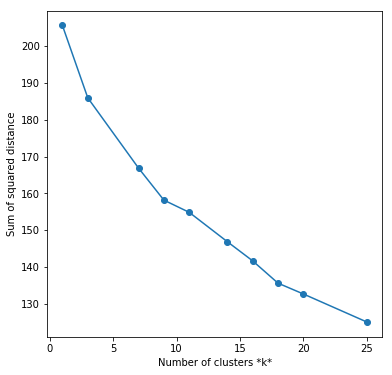

In [16]:
#Identify the best k value
true_k =[1,3,7,9,11,14,16,18,20,25]
sse=[]
KMeansModelsLs =[]
for indx in range(0,len(true_k)):
    KMeansModelsLs += [KMeans(n_clusters=true_k[indx],init="k-means++", max_iter=100, n_init=1,random_state=3452)]
    KMeansModelsLs[-1].fit(xTrain)
    sse.append(KMeansModelsLs[-1].inertia_)
    print(sse)
# Plot sse against k
plt.figure(figsize=(6, 6))
plt.plot(true_k, sse, '-o')
plt.xlabel(r'Number of clusters *k*')
plt.ylabel('Sum of squared distance');


[146.9440832789929]


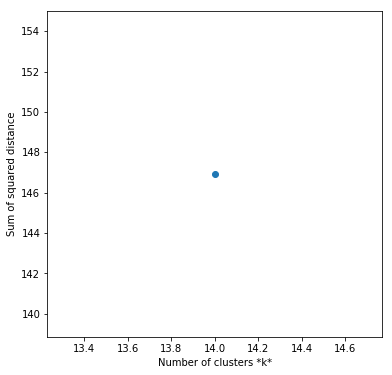

In [20]:
"""
#Identify the best k value
true_k =[1,3,7,9,11,14,16,18,20,25]
sse=[]
KMeansModelsLs =[]
for indx in range(0,len(true_k)):
    KMeansModelsLs += [AgglomerativeClustering(n_clusters=true_k[indx])]
    KMeansModelsLs[-1].fit(xTrain)
    sse.append(KMeansModelsLs[-1].inertia_)
    print(sse)
# Plot sse against k
plt.figure(figsize=(6, 6))
plt.plot(true_k, sse, '-o')
plt.xlabel(r'Number of clusters *k*')
plt.ylabel('Sum of squared distance');
"""
true_k =[14]
sse=[]
KMeansModelsLs =[]
for indx in range(0,len(true_k)):
    KMeansModelsLs += [KMeans(n_clusters=true_k[indx],init="k-means++", max_iter=100, n_init=1,random_state=3452)]
    KMeansModelsLs[-1].fit(xTrain)
    sse.append(KMeansModelsLs[-1].inertia_)
    print(sse)
# Plot sse against k
plt.figure(figsize=(6, 6))
plt.plot(true_k, sse, '-o')
plt.xlabel(r'Number of clusters *k*')
plt.ylabel('Sum of squared distance');

#  Show the results

In [0]:
# Prediction for training.
termsLs =[]
for KmsModlindx in range(0,len(KMeansModelsLs)):
    print("Kmeans number of cluster",true_k[indx])
    order_centroids = KMeansModelsLs[-1].cluster_centers_.argsort()[:, ::-1]
    #print(order_centroids)
    terms = vectorizer.get_feature_names()
    #print(terms)
    for i in range(true_k[indx]):
        print("Cluster %d:" % i),
        for ind in order_centroids[i,:]:
            #print(ind)
            print(' %s' % terms[ind])
            termsLs +=[terms[ind]]
    print("\n")
    print("Prediction")
 

Kmeans number of cluster 14
Cluster 0:
 https
 www
 github
 youtube
 http
 microservices
 html
 cdk
 twitter
 ai
 com
 php
 slides
 pdf
 medium
 learning
 video
 schd
 service
 code
 blog
 google
 web
 design
 api
 googleblog
 data
 cloud
 using
 spring
 kubernetes
 software
 aws
 architecture
 microservice
 services
 deep
 git
 laravel
 build
 mo
 martinfowler
 chaos
 project
 topics
 react
 docker
 programming
 learnhowtoprogram
 awesome
 testing
 comupcoursemicroservicekmitltreemasterslideday
 engineering
 use
 open
 application
 nestjs
 arrowdown
 slideshare
 developers
 microsoft
 io
 js
 youtu
 app
 java
 org
 docs
 javascript
 openreq
 star
 security
 cran
 tools
 create
 python
 amazon
 development
 applications
 run
 example
 restful
 infoq
 patterns
 systems
 pvmdemo
 server
 udemy
 formapro
 tutorial
 new
 building
 source
 best
 functional
 comphpenqueueenqueuedevpull
 azure
 akka
 framework
 netelias
 devops
 research
 rstudio
 management
 distributed
 install
 repository


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




 febpark
 febpaulus
 febpearl
 febpeck
 febperry
 febpershing
 febpier
 febpike
 febpitt
 febpulaski
 febputnam
 febqueens
 febr
 febrailroad
 febreade
 febrerachea
 febrewaris
 febriverside
 febriverview
 febrivington
 febrièr
 febroebling
 febw
 febwashington
 cloadviewmodel
 fechas
 fecmallfecshop
 comzhenlohuangawesomedistributedsystems
 basewidth
 fecp
 basewebpathforimgresources
 fecshopyiifecshop
 fecx
 basewebpackrequire
 basewebpackconfig
 fedak
 fedata
 fedbf
 fedcba
 fedd
 clipboardc
 fede
 comzhengminropstepbystep
 comzhengjingxluareqstatus
 fedeg
 federación
 baseviewmodel
 federalbrazilsouth
 clipboarddataa
 feckeditor
 fecharprevtext
 febwater
 fechar
 febwatts
 febwest
 febwilliam
 febwilloughby
 febwythe
 febyankee
 febyork
 baseyr
 baseyeardata
 clipbias
 fecb
 comzhiyicxthinksnsplus
 fecceebeccfb
 fecdcdebabd
 fecdcdebabdns
 comzhhchenluarestyhandlersocket
 comzhhchenluarestygearman
 fecdf
 fecebeffffeceddaafeade
 fecefbbec
 fecefor
 comzhgooglestyleguidezhgooglesty

In [0]:
for KmsModlindx in range(0,len(KMeansModelsLs)):
       prediction = KMeansModelsLs[KmsModlindx].predict(xtest)
print(prediction)

In [0]:
# Prediction for Testing.
for KmsModlindx in range(0,len(KMeansModelsLs)):
    print("Kmeans number of cluster",true_k[indx])
    order_centroids = KMeansModelsLs[-1].cluster_centers_.argsort()[:, ::-1]
    #print(order_centroids)
    terms = vectorizer.get_feature_names()
    #print(terms)
    for clusterIndx in range(true_k[indx]):
        print("Cluster %d:" % clusterIndx),
        for ind in order_centroids[clusterIndx,50:60]:
          #print(ind)
          print(' %s' % terms[ind])
          
    print("\n")
    print("Prediction")
    prediction =  KMeansModelsLs[-1].predict(xTest[0:20])
    print(prediction) 

In [0]:
wordcloud = WordCloud(width = 1000, height = 1000, 
                background_color ='white', 
                min_font_size = 10).generate(' '.join(terms[12])) 


In [0]:
plt.imshow(wordcloud)

In [0]:
terms=np.array(termsLs)

In [0]:
terms=terms.reshape(true_k[0],xtrain.shape[1])

# Classification 

In [0]:
#SVM=svm.SVC(C=3.0,gamma='scale',random_state=42)
#SVM.fit(xTrain,yTrain) 77% training 15 to 19% test
#mlp = MLPClassifier(hidden_layer_sizes=(64,),learning_rate='adaptive',validation_fraction=.2,solver='lbfgs',batch_size=5,verbose=1)
#22 % training 20% test using hidden_layers 10 and batch_size = 100
lgrCV=LogisticRegressionCV(cv=5,multi_class='multinomial',max_iter=200,verbose=1)

In [0]:
import gc
gc.collect()
#Simple Neural nets by using Keras.
NN = Sequential()
NN.add(Embedding(input_dim=xTrain.shape[0],input_length=xTrain.shape[1],output_dim=10))
NN.add(Flatten())
NN.add(Dense(14,activation='softmax')) 

#yTrain.shape

In [0]:
'''
startB=0
for indx in range(0,int(len(yTrain))):
        mlp.fit(xTrain[startB:startB+1].toarray(),yTrain[startB:startB+1])
        startB+=1 
'''
#NN.compile(optimizer='adam', 
              #loss='categorical_crossentropy')
#NN.fit(xTrain,yTrain,validation_split=0.2,epochs=10,batch_size=4)
#NN.fit_generator(data_generator(xTrain.toarray()[:1],yTrain[:1],1),validation_data=data_generator(xVal.toarray()[:1],yVal[:1],1),steps_per_epoch=1,epochs=100,validation_steps=1)
#mlp.fit(xTrain.toarray(),yTrain)
lgrCV.fit(xTrain,yTrain)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


In [0]:
xTrain.toarray()[:indx]

In [0]:
SVM.score(xTrain,yTrain)

In [0]:
mlp.score(xTrain,yTrain)*100

In [0]:
yPred=SVM.predict(xTest)

In [0]:
yPred = mlp.predict(xTest)

In [0]:
accuracy_score(yTest,yPred,normalize=True)*100